In [1]:
pip install geopandas

Note: you may need to restart the kernel to use updated packages.


In [2]:
import os
import numpy as np
import pandas as pd
import seaborn as sns
from scipy import stats
import matplotlib.pyplot as plt
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import OneHotEncoder, Normalizer, StandardScaler, MinMaxScaler
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report
from imblearn.over_sampling import SMOTE
from imblearn.under_sampling import TomekLinks
import matplotlib.pyplot as plt
from sklearn.neighbors import KNeighborsRegressor
from sklearn.neural_network import MLPRegressor
from imblearn.under_sampling import RandomUnderSampler
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import RandomForestRegressor
from geopy.geocoders import GoogleV3
from geopy.exc import GeocoderServiceError
import geopandas as gpd
from shapely.geometry import Point
import plotly.express as px
from plotly.express import histogram
from plotly.express import scatter_geo

In [3]:
df = pd.read_csv("C:\\Users\\Seijsener\\Downloads\\earthquakes_2023_global (1).csv")
df

,time,latitude,longitude,depth,mag,magType,nst,gap,dmin,rms,...,updated,place,type,horizontalError,depthError,magError,magNst,status,locationSource,magSource
0,2023-01-01T00:49:25.294Z,52.0999,178.5218,82.770,3.10,ml,14.0,139.0,0.8700,0.18,...,2023-03-11T22:51:52.040Z,"Rat Islands, Aleutian Islands, Alaska",earthquake,8.46,21.213,0.097,14.0,reviewed,us,us
1,2023-01-01T01:41:43.755Z,7.1397,126.7380,79.194,4.50,mb,32.0,104.0,1.1520,0.47,...,2023-03-11T22:51:45.040Z,"23 km ESE of Manay, Philippines",earthquake,5.51,7.445,0.083,43.0,reviewed,us,us
2,2023-01-01T03:29:31.070Z,19.1631,-66.5251,24.000,3.93,md,23.0,246.0,0.8479,0.22,...,2023-03-11T22:51:29.040Z,Puerto Rico region,earthquake,0.91,15.950,0.090,16.0,reviewed,pr,pr
3,2023-01-01T04:09:32.814Z,-4.7803,102.7675,63.787,4.30,mb,17.0,187.0,0.4570,0.51,...,2023-03-11T22:51:45.040Z,"99 km SSW of Pagar Alam, Indonesia",earthquake,10.25,6.579,0.238,5.0,reviewed,us,us
4,2023-01-01T04:29:13.793Z,53.3965,-166.9417,10.000,3.00,ml,19.0,190.0,0.4000,0.31,...,2023-03-11T22:51:38.040Z,"59 km SSW of Unalaska, Alaska",earthquake,1.41,1.999,0.085,18.0,reviewed,us,us
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
26637,2023-12-29T03:37:19.334Z,-6.9527,154.9829,10.000,5.20,mb,72.0,60.0,3.9240,0.93,...,2023-12-29T04:05:57.040Z,"89 km SW of Panguna, Papua New Guinea",earthquake,10.07,1.765,0.048,141.0,reviewed,us,us
26638,2023-12-29T04:38:54.109Z,32.3262,141.7386,10.000,5.10,mb,74.0,121.0,1.8030,0.70,...,2023-12-29T10:59:44.533Z,"Izu Islands, Japan region",earthquake,9.17,1.870,0.042,187.0,reviewed,us,us
26639,2023-12-29T08:42:05.747Z,-7.2411,68.0663,10.000,5.10,mb,60.0,54.0,12.7760,0.57,...,2023-12-29T08:57:05.040Z,Chagos Archipelago region,earthquake,8.02,1.792,0.090,40.0,reviewed,us,us
26640,2023-12-29T11:02:48.679Z,-19.1602,169.0428,153.264,4.70,mb,40.0,61.0,3.7460,0.82,...,2023-12-29T11:22:46.040Z,"49 km NNW of Isangel, Vanuatu",earthquake,8.52,7.433,0.081,46.0,reviewed,us,us


# Preprocessing the Dataset

In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 26642 entries, 0 to 26641
Data columns (total 22 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   time             26642 non-null  object 
 1   latitude         26642 non-null  float64
 2   longitude        26642 non-null  float64
 3   depth            26642 non-null  float64
 4   mag              26642 non-null  float64
 5   magType          26642 non-null  object 
 6   nst              25227 non-null  float64
 7   gap              25225 non-null  float64
 8   dmin             24776 non-null  float64
 9   rms              26642 non-null  float64
 10  net              26642 non-null  object 
 11  id               26642 non-null  object 
 12  updated          26642 non-null  object 
 13  place            25034 non-null  object 
 14  type             26642 non-null  object 
 15  horizontalError  25093 non-null  float64
 16  depthError       26642 non-null  float64
 17  magError    

In [5]:
df.describe()

,latitude,longitude,depth,mag,nst,gap,dmin,rms,horizontalError,depthError,magError,magNst
count,26642.000000,26642.000000,26642.000000,26642.000000,25227.000000,25225.000000,24776.000000,26642.000000,25093.000000,26642.000000,24970.000000,25065.000000
mean,16.852798,-11.487497,67.491224,4.007395,42.571332,124.930971,2.692908,0.581575,7.017267,4.475056,0.122735,33.315939
std,30.389200,130.053399,116.762456,0.794423,37.662352,67.430145,4.043568,0.256276,4.072365,4.451649,0.102271,48.022567
min,-65.849700,-179.998700,-3.370000,2.600000,0.000000,8.000000,0.000000,0.010000,0.000000,0.000000,0.000000,0.000000
25%,-6.415275,-149.608650,10.000000,3.220000,19.000000,73.000000,0.612000,0.410000,4.140000,1.848000,0.080000,10.000000
50%,18.884167,-64.811833,21.998000,4.300000,30.000000,111.000000,1.579000,0.590000,7.060000,2.019000,0.111000,18.000000
75%,41.827950,126.965100,66.833000,4.500000,52.000000,165.000000,3.172000,0.750000,9.730000,6.669000,0.150000,36.000000
max,86.593900,179.999400,681.238000,7.800000,423.000000,350.000000,50.820000,1.880000,99.000000,60.670000,4.490000,884.000000


In [6]:
df.columns

Index(['time', 'latitude', 'longitude', 'depth', 'mag', 'magType', 'nst',
       'gap', 'dmin', 'rms', 'net', 'id', 'updated', 'place', 'type',
       'horizontalError', 'depthError', 'magError', 'magNst', 'status',
       'locationSource', 'magSource'],
      dtype='object')

In [7]:
#checking missing values
df.isnull().sum()

time                  0
latitude              0
longitude             0
depth                 0
mag                   0
magType               0
nst                1415
gap                1417
dmin               1866
rms                   0
net                   0
id                    0
updated               0
place              1608
type                  0
horizontalError    1549
depthError            0
magError           1672
magNst             1577
status                0
locationSource        0
magSource             0
dtype: int64

In [8]:
#check duplicate values
df.duplicated().sum()

1960

In [9]:
duplicates = df[df.duplicated()]
print("Number of duplicate rows:", len(duplicates))

Number of duplicate rows: 1960


# Data Cleaning

In [10]:
# Remove duplicate rows
df.drop_duplicates(inplace=True)

In [11]:
# Verify that duplicates have been removed
print("Number of duplicate rows after removal:", len(df[df.duplicated()]))

Number of duplicate rows after removal: 0


In [12]:
# fill the null value
df['nst'].fillna(df['nst'].mean(), inplace=True)
df['gap'].fillna(df['gap'].mean(), inplace=True)
df['dmin'].fillna(df['dmin'].mean(), inplace=True)
df['horizontalError'].fillna(df['horizontalError'].mean(), inplace=True)
df['magError'].fillna(df['magError'].mean(), inplace=True)
df['magNst'].fillna(df['magNst'].mean(), inplace=True)

In [13]:
# Verifying
df.isnull().sum()

time                  0
latitude              0
longitude             0
depth                 0
mag                   0
magType               0
nst                   0
gap                   0
dmin                  0
rms                   0
net                   0
id                    0
updated               0
place              1466
type                  0
horizontalError       0
depthError            0
magError              0
magNst                0
status                0
locationSource        0
magSource             0
dtype: int64

Filling missing values in the "place" column

Geospatial Information: If you have latitude and longitude coordinates for each earthquake event, you could use geocoding services to reverse-geocode these coordinates into place names (city, region, country) and fill missing values accordingly.

In [14]:
# the geocoding didn't work!! so im filling the missing values with unknown
# For 'place' column, fill missing values with 'Unknown'
df['place'].fillna('Unknown', inplace=True)

In [15]:
df.isnull().sum()

time               0
latitude           0
longitude          0
depth              0
mag                0
magType            0
nst                0
gap                0
dmin               0
rms                0
net                0
id                 0
updated            0
place              0
type               0
horizontalError    0
depthError         0
magError           0
magNst             0
status             0
locationSource     0
magSource          0
dtype: int64

In [16]:
#converting the values in the "time" column to datetime objects

In [17]:
df['time'] = pd.to_datetime(df['time'])

# Now 'time' column is converted to datetime format
print(df['time'])

0       2023-01-01 00:49:25.294000+00:00
1       2023-01-01 01:41:43.755000+00:00
2       2023-01-01 03:29:31.070000+00:00
3       2023-01-01 04:09:32.814000+00:00
4       2023-01-01 04:29:13.793000+00:00
                      ...               
26637   2023-12-29 03:37:19.334000+00:00
26638   2023-12-29 04:38:54.109000+00:00
26639   2023-12-29 08:42:05.747000+00:00
26640   2023-12-29 11:02:48.679000+00:00
26641   2023-12-29 16:31:16.656000+00:00
Name: time, Length: 24682, dtype: datetime64[ns, UTC]


# visualizations


 Correlations
                 latitude  longitude     depth       mag       nst       gap  \
latitude         1.000000  -0.241675 -0.277305 -0.570582  0.000291  0.286917   
longitude       -0.241675   1.000000 -0.033467  0.527862  0.137636 -0.270239   
depth           -0.277305  -0.033467  1.000000  0.155996  0.061729 -0.176233   
mag             -0.570582   0.527862  0.155996  1.000000  0.482339 -0.490034   
nst              0.000291   0.137636  0.061729  0.482339  1.000000 -0.470415   
gap              0.286917  -0.270239 -0.176233 -0.490034 -0.470415  1.000000   
dmin            -0.333983   0.175410  0.039572  0.327704  0.061380 -0.163628   
rms             -0.179120   0.207181  0.108280  0.461476  0.169950 -0.240589   
horizontalError -0.384312   0.292955  0.416013  0.459610  0.013481 -0.127781   
depthError      -0.102154   0.040634  0.329789  0.048323 -0.137139  0.228713   
magError        -0.069542  -0.038034 -0.036574 -0.125274 -0.240562  0.055576   
magNst           0.023059

<Figure size 640x480 with 0 Axes>

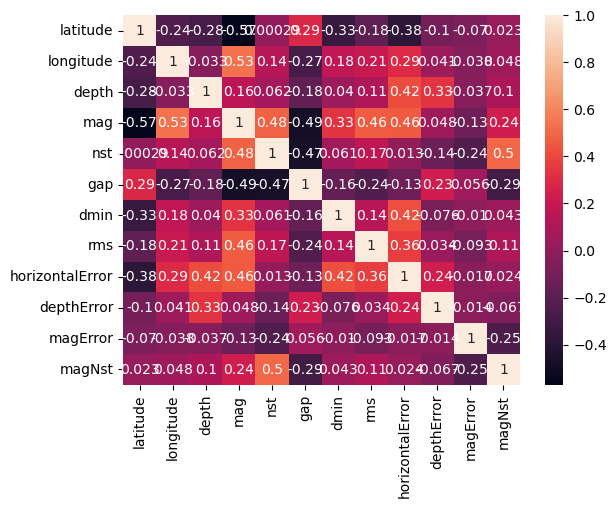

<Figure size 640x480 with 0 Axes>

In [18]:
print("\n Correlations")
print(df.corr(numeric_only=True))
sns.heatmap(df.corr(numeric_only=True), annot=True)
plt.figure()

In [19]:
#correlation coefficients in percentage form
correlation_percentage = df.corr(numeric_only=True) * 100
print(correlation_percentage)

                   latitude   longitude       depth         mag         nst  \
latitude         100.000000  -24.167524  -27.730504  -57.058150    0.029056   
longitude        -24.167524  100.000000   -3.346696   52.786224   13.763607   
depth            -27.730504   -3.346696  100.000000   15.599639    6.172939   
mag              -57.058150   52.786224   15.599639  100.000000   48.233874   
nst                0.029056   13.763607    6.172939   48.233874  100.000000   
gap               28.691712  -27.023887  -17.623317  -49.003419  -47.041519   
dmin             -33.398300   17.540997    3.957155   32.770422    6.137994   
rms              -17.912029   20.718056   10.827988   46.147649   16.994988   
horizontalError  -38.431214   29.295491   41.601266   45.960989    1.348100   
depthError       -10.215397    4.063396   32.978864    4.832260  -13.713947   
magError          -6.954187   -3.803368   -3.657384  -12.527363  -24.056235   
magNst             2.305869    4.835515   10.173401 

As we can see 
-Latitude has a strong negative correlation with magnitude (-57.06%) and a strong positive correlation with gap (28.69%).

-Longitude has a strong positive correlation with magnitude (52.79%) and a strong negative correlation with gap (-27.02%).

-Depth has a weak positive correlation with magnitude (15.60%) and a weak positive correlation with horizontal error (41.60%).

C:\Users\Seijsener\.conda\New folderX\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
C:\Users\Seijsener\.conda\New folderX\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
C:\Users\Seijsener\.conda\New folderX\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
C:\Users\Seijsener\.conda\New folderX\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
C:\Users\Seijsener\.conda\New folderX\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
C:\Users\Seijsener\.conda\New folderX\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layou

<Figure size 640x480 with 0 Axes>

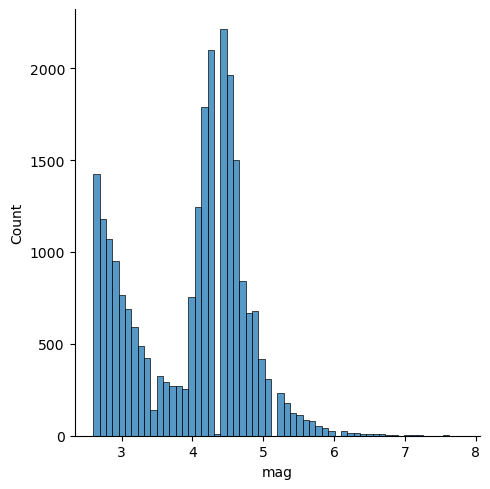

<Figure size 640x480 with 0 Axes>

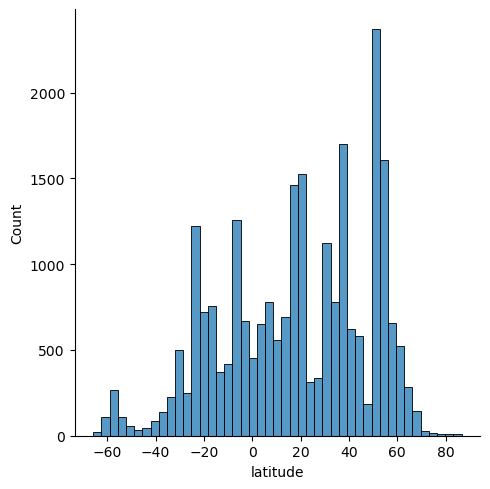

<Figure size 640x480 with 0 Axes>

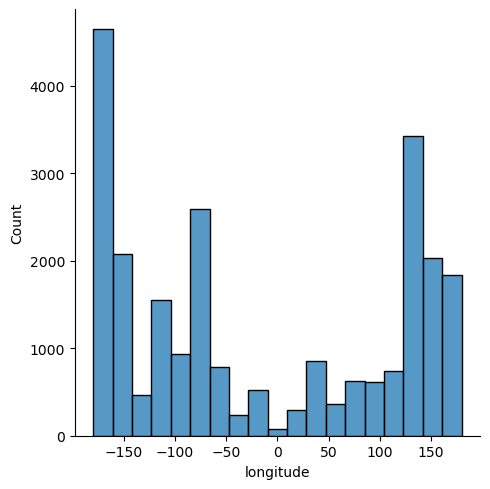

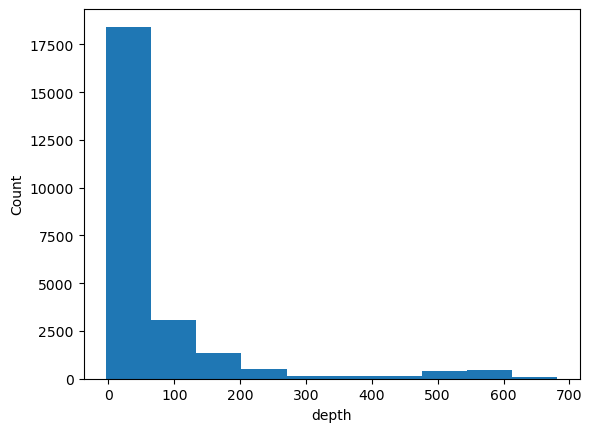

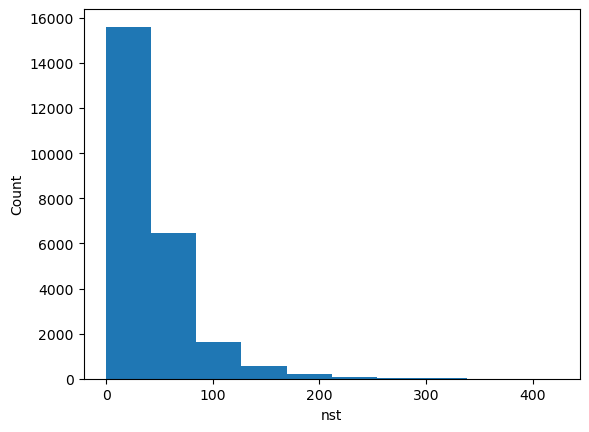

<Figure size 640x480 with 0 Axes>

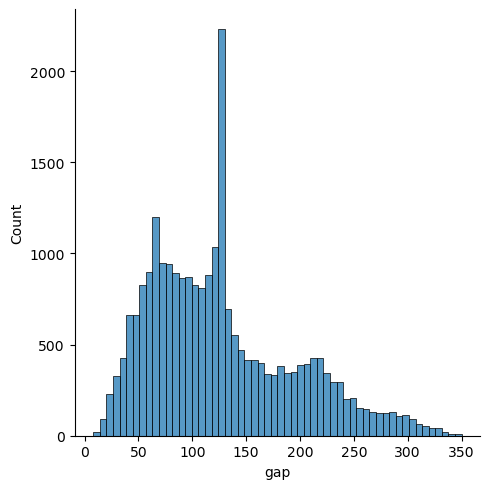

<Figure size 640x480 with 0 Axes>

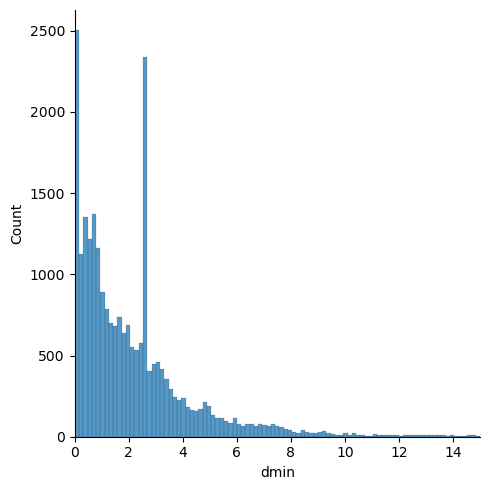

<Figure size 640x480 with 0 Axes>

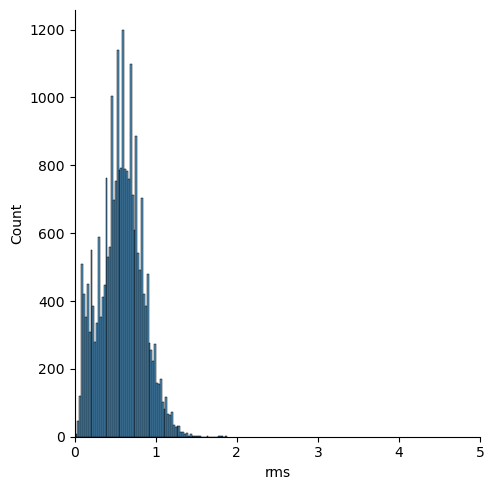

<Figure size 640x480 with 0 Axes>

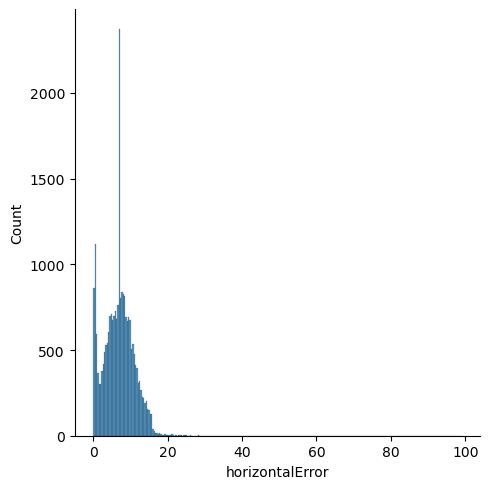

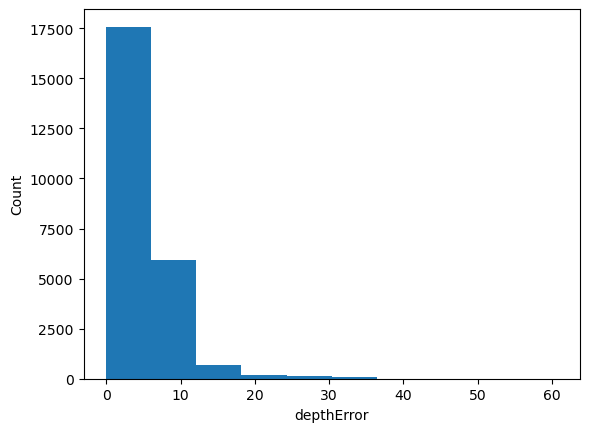

<Figure size 640x480 with 0 Axes>

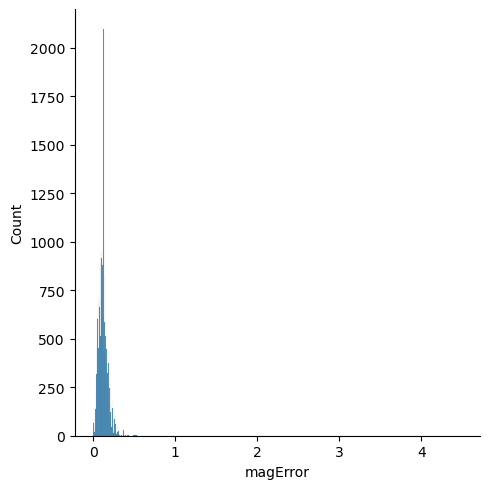

<Figure size 640x480 with 0 Axes>

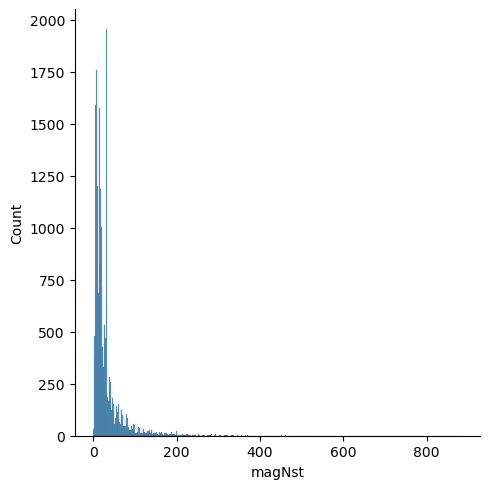

<Figure size 640x480 with 0 Axes>

In [20]:
# Histogram and Displot for 'mag' variable
sns.displot(df["mag"])
plt.figure()

# Displot for 'latitude' variable
sns.displot(df["latitude"])
plt.figure()

# Displot for 'longitude' variable
sns.displot(df["longitude"])
plt.figure()

# Histogram for 'depth' variable
plt.hist(df["depth"])
plt.xlabel("depth")
plt.ylabel("Count")
plt.figure()

# Histogram for 'nst' variable
plt.hist(df["nst"])
plt.xlabel("nst")
plt.ylabel("Count")
plt.figure()

# Displot for 'gap' variable
sns.displot(df["gap"])
plt.figure()

# Displot for 'dmin' variable with x-axis limit set
sns.displot(df["dmin"])
plt.xlim(0, 15)
plt.figure()

# Displot for 'rms' variable with x-axis limit set
sns.displot(df["rms"])
plt.xlim(0, 5)
plt.figure()

# Displot for 'horizontalError' variable
sns.displot(df["horizontalError"])
plt.figure()

# Histogram for 'depthError' variable
plt.hist(df["depthError"])
plt.xlabel("depthError")
plt.ylabel("Count")
plt.figure()

# Displot for 'magError' variable
sns.displot(df["magError"])
plt.figure()

# Displot for 'magNst' variable
sns.displot(df["magNst"])
plt.figure()


 Covariances
mag x nst: 14.60236897346962
mag x horizontalError: 1.4874014266698299
dmin x horizontalError: 6.276108990542248
mag x rms: 0.09659455267827495


<Figure size 640x480 with 0 Axes>

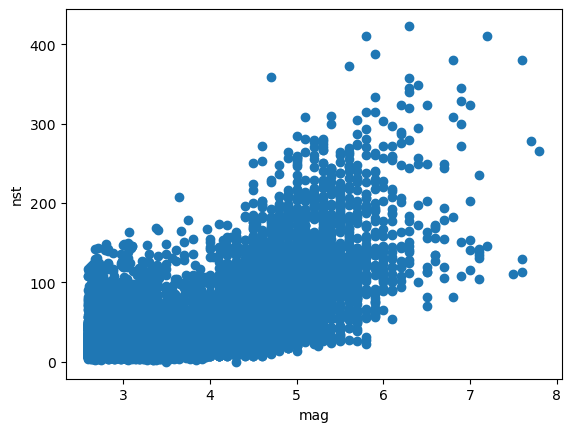

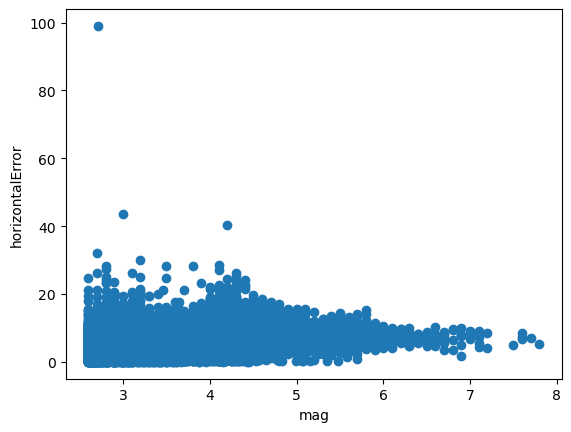

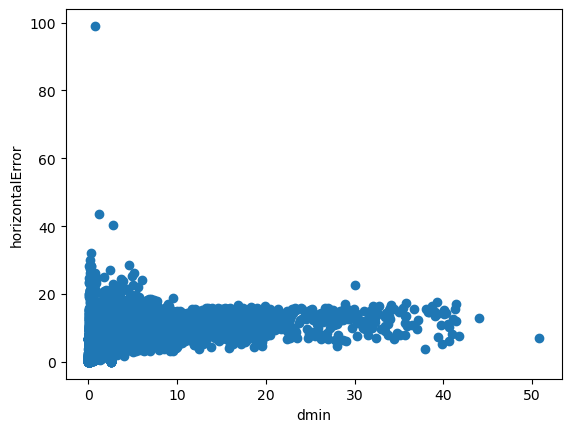

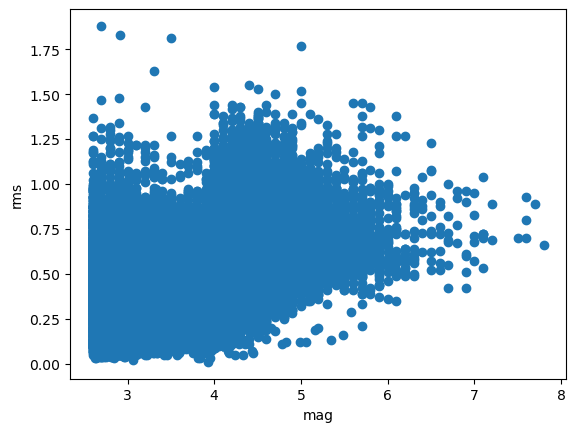

<Figure size 640x480 with 0 Axes>

In [21]:
print("\n Covariances")

# Covariance analysis between selected variables
covariance = df["mag"].cov(df["nst"])
print("mag x nst:", covariance)

plt.scatter(df["mag"], df["nst"])
plt.xlabel("mag")
plt.ylabel("nst")
plt.figure()

covariance = df["mag"].cov(df["horizontalError"])
print("mag x horizontalError:", covariance)

plt.scatter(df["mag"], df["horizontalError"])
plt.xlabel("mag")
plt.ylabel("horizontalError")
plt.figure()

covariance = df["dmin"].cov(df["horizontalError"])
print("dmin x horizontalError:", covariance)

plt.scatter(df["dmin"], df["horizontalError"])
plt.xlabel("dmin")
plt.ylabel("horizontalError")
plt.figure()

covariance = df["mag"].cov(df["rms"])
print("mag x rms:", covariance)

plt.scatter(df["mag"], df["rms"])
plt.xlabel("mag")
plt.ylabel("rms")
plt.figure()

C:\Users\Seijsener\.conda\New folderX\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 640x480 with 0 Axes>

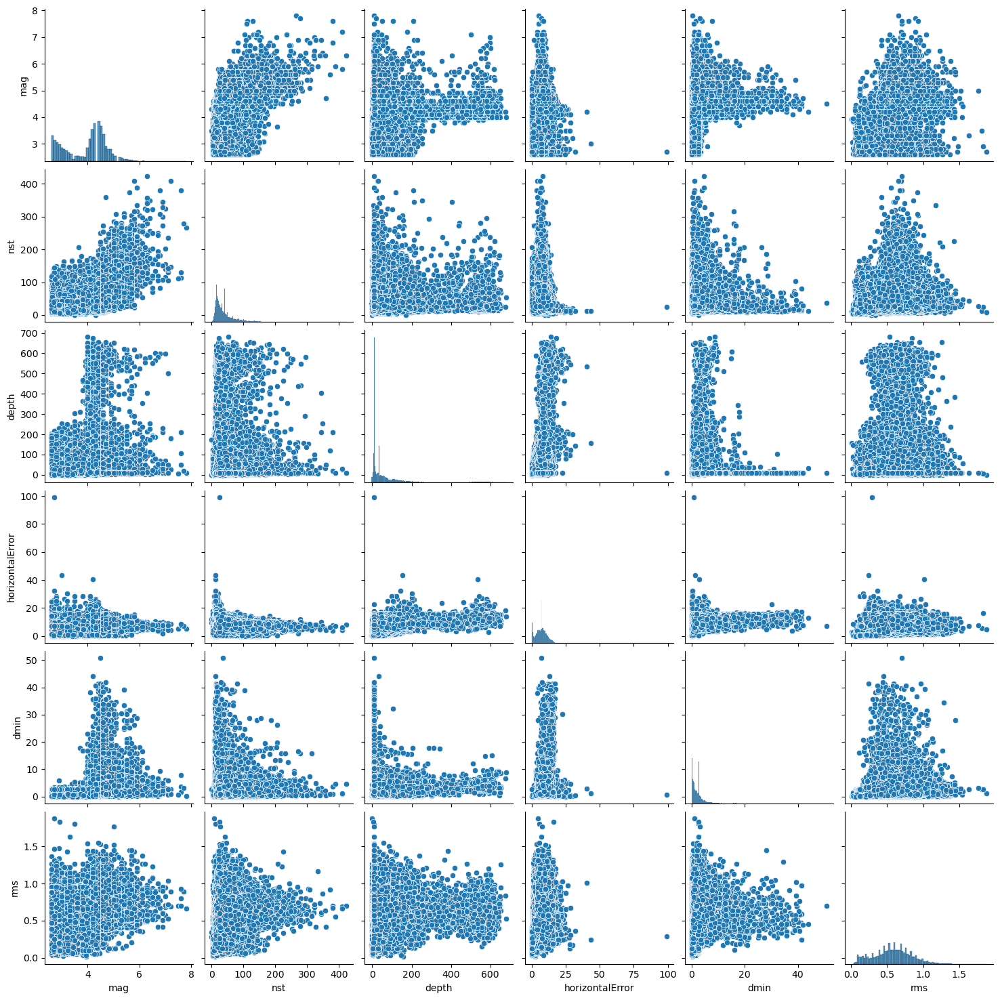

<Figure size 640x480 with 0 Axes>

In [22]:
# Pairplot for variables with high correlation
selected_columns = ['mag', 'nst', 'depth', 'horizontalError', 'dmin', 'rms']
sns.pairplot(df[selected_columns])
plt.figure()

In [23]:
for column in ["time","latitude","longitude","depth","place","magError"]:
    histogram(data_frame=df,x=column).show()

In [24]:
for column in ["mag","magType","gap","dmin","status","type","magSource"]:
    histogram(data_frame=df,x=column).show()

In [25]:
fig=px.histogram(df
                ,x="locationSource",
                title="Location of earthquake and number of events",
                width=300,
                height=450)
fig.update_layout(font=dict(size=8))
fig.show()

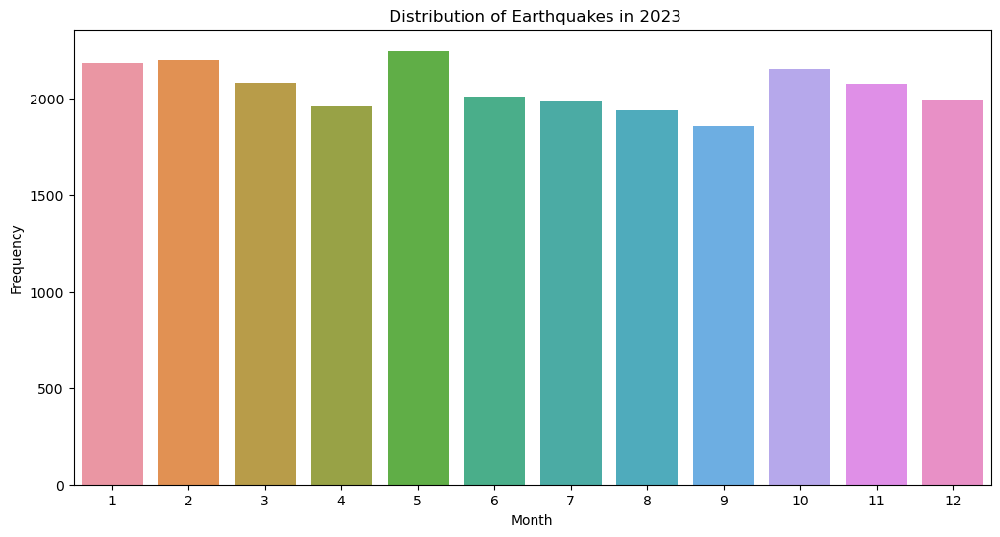

In [26]:
df["month"]=pd.to_datetime(df["time"]).dt.month

plt.figure(figsize=(12, 6))
sns.countplot(x='month', data=df,)
plt.title(' Distribution of Earthquakes in 2023')
plt.xlabel('Month')
plt.ylabel('Frequency')
plt.show()

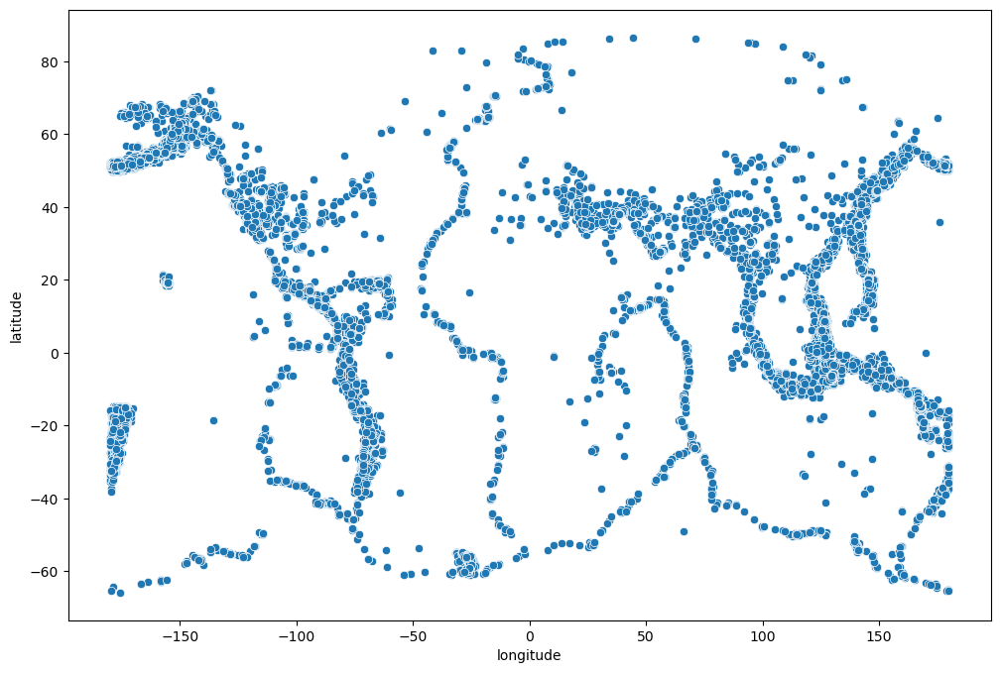

In [27]:
plt.figure(figsize=(12,8))
sns.scatterplot(data=df,x="longitude",y="latitude")
plt.xlabel("longitude")
plt.ylabel("latitude")
plt.show()

<Axes: xlabel='depthError', ylabel='gap'>

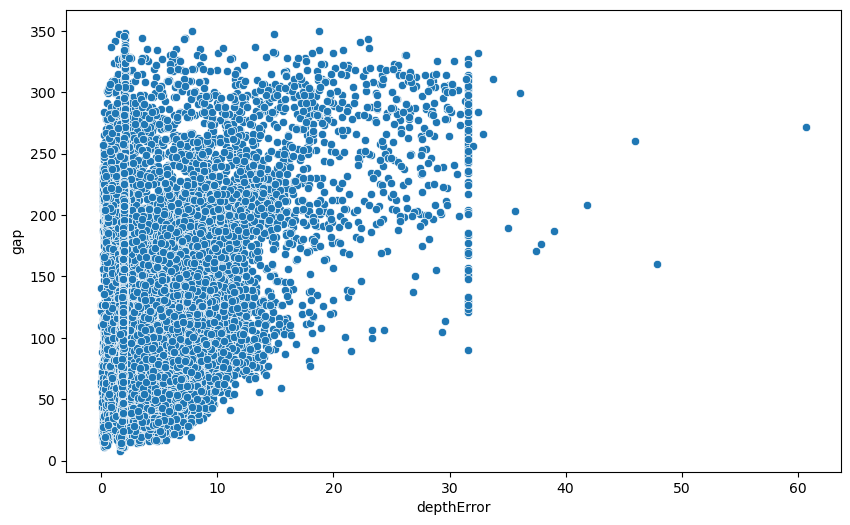

In [28]:
plt.figure(figsize=(10,6))
sns.scatterplot(data=df,x="depthError",y="gap")

In [29]:
scatter_geo(data_frame=df, lat='latitude', lon='longitude',  color='mag', hover_name='place').show()    
scatter_geo(data_frame=df, lat='latitude', lon='longitude',  color='magType', hover_name='place').show()

# Machine Learning

Extracting additional features from the timestamp:

In [30]:
# Convert 'Time' column to datetime format
df['time'] = pd.to_datetime(df['time'])
# Extract year, month, day, hour features
df['Year'] = df['time'].dt.year
df['Month'] = df['time'].dt.month
df['Day'] = df['time'].dt.day
df['Hour'] = df['time'].dt.hour

In [31]:
df

,time,latitude,longitude,depth,mag,magType,nst,gap,dmin,rms,...,magError,magNst,status,locationSource,magSource,month,Year,Month,Day,Hour
0,2023-01-01 00:49:25.294000+00:00,52.0999,178.5218,82.770,3.10,ml,14.0,139.0,0.8700,0.18,...,0.097,14.0,reviewed,us,us,1,2023,1,1,0
1,2023-01-01 01:41:43.755000+00:00,7.1397,126.7380,79.194,4.50,mb,32.0,104.0,1.1520,0.47,...,0.083,43.0,reviewed,us,us,1,2023,1,1,1
2,2023-01-01 03:29:31.070000+00:00,19.1631,-66.5251,24.000,3.93,md,23.0,246.0,0.8479,0.22,...,0.090,16.0,reviewed,pr,pr,1,2023,1,1,3
3,2023-01-01 04:09:32.814000+00:00,-4.7803,102.7675,63.787,4.30,mb,17.0,187.0,0.4570,0.51,...,0.238,5.0,reviewed,us,us,1,2023,1,1,4
4,2023-01-01 04:29:13.793000+00:00,53.3965,-166.9417,10.000,3.00,ml,19.0,190.0,0.4000,0.31,...,0.085,18.0,reviewed,us,us,1,2023,1,1,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
26637,2023-12-29 03:37:19.334000+00:00,-6.9527,154.9829,10.000,5.20,mb,72.0,60.0,3.9240,0.93,...,0.048,141.0,reviewed,us,us,12,2023,12,29,3
26638,2023-12-29 04:38:54.109000+00:00,32.3262,141.7386,10.000,5.10,mb,74.0,121.0,1.8030,0.70,...,0.042,187.0,reviewed,us,us,12,2023,12,29,4
26639,2023-12-29 08:42:05.747000+00:00,-7.2411,68.0663,10.000,5.10,mb,60.0,54.0,12.7760,0.57,...,0.090,40.0,reviewed,us,us,12,2023,12,29,8
26640,2023-12-29 11:02:48.679000+00:00,-19.1602,169.0428,153.264,4.70,mb,40.0,61.0,3.7460,0.82,...,0.081,46.0,reviewed,us,us,12,2023,12,29,11


Lag features capture the past values of a variable, which can be useful for time-series forecasting tasks. Here, we'll create lag features for the earthquake magnitude.

In [32]:
# Define the number of lag periods
num_lags = 3

# Create lag features
for i in range(1, num_lags+1):
    df[f'Mag_Lag_{i}'] = df['mag'].shift(i)

Rolling statistics compute summary metrics over a moving window of data, which can help capture trends and patterns. Here, we'll calculate the rolling mean and standard deviation of earthquake magnitude.

In [33]:
# Define the window size for rolling statistics
window_size = 7

# Compute rolling mean and standard deviation
df['Mag_Rolling_Mean'] = df['mag'].rolling(window=window_size).mean()
df['Mag_Rolling_Std'] = df['mag'].rolling(window=window_size).std()

Interaction terms capture the combined effect of two or more features. Here, we'll create an interaction term between latitude and longitude.

In [34]:
# Create interaction term
df['Lat_Long_Interaction'] = df['latitude'] * df['longitude']

Cyclical features, such as month and hour, exhibit a repeating pattern over time. Converting them into trigonometric representations can help capture their cyclical nature.

In [35]:
# Transform month and hour into sine and cosine representations
df['Month_Sin'] = np.sin(2 * np.pi * df['Month'] / 12)
df['Month_Cos'] = np.cos(2 * np.pi * df['Month'] / 12)
df['Hour_Sin'] = np.sin(2 * np.pi * df['Hour'] / 24)
df['Hour_Cos'] = np.cos(2 * np.pi * df['Hour'] / 24)

scaling numerical features and encoding categorical variables.

In [36]:
numerical_columns = ['depth', 'mag', 'nst', 'gap', 'dmin', 'rms', 'horizontalError', 'depthError', 'magError', 'magNst']

scaler = MinMaxScaler()

df[numerical_columns] = scaler.fit_transform(df[numerical_columns])

df = pd.get_dummies(df, columns=['magType', 'net', 'status', 'locationSource', 'magSource'], drop_first=True)

 Let's proceed with splitting the dataset into training and testing sets. We typically split the data into two parts: one for training the model and the other for evaluating its performance.

In [37]:
X = df.drop(columns=['mag', 'time', 'place', 'type', 'updated', 'id'])
y = df['mag']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

print("Training set shape:", X_train.shape, y_train.shape)
print("Testing set shape:", X_test.shape, y_test.shape)

Training set shape: (19745, 88) (19745,)
Testing set shape: (4937, 88) (4937,)


"model1" using Linear Regression and evaluate its performance:

In [38]:
from sklearn.impute import SimpleImputer

imputer = SimpleImputer(strategy='mean')

X_train_imputed = imputer.fit_transform(X_train)

X_test_imputed = imputer.transform(X_test)

model1 = LinearRegression()

model1.fit(X_train_imputed, y_train)

y_pred = model1.predict(X_test_imputed)

mse = mean_squared_error(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

print("Mean Squared Error:", mse)
print("Mean Absolute Error:", mae)
print("R^2 Score:", r2)

Mean Squared Error: 0.002322227723603355
Mean Absolute Error: 0.035473499341438494
R^2 Score: 0.9041000137498733


Overall, these metrics suggest that your linear regression model is performing well in predicting earthquake magnitudes based on the given features.

In [39]:
# Check for missing values in X_train and X_test
missing_values_train = X_train.isnull().sum()
missing_values_test = X_test.isnull().sum()

print("Missing values in training set:")
print(missing_values_train[missing_values_train > 0])

print("\nMissing values in testing set:")
print(missing_values_test[missing_values_test > 0])


Missing values in training set:
Mag_Lag_1           1
Mag_Lag_2           2
Mag_Lag_3           3
Mag_Rolling_Mean    6
Mag_Rolling_Std     6
dtype: int64

Missing values in testing set:
Series([], dtype: int64)


applying imputation to fill in the missing values. We'll use the SimpleImputer from scikit-learn to replace the missing values with a chosen strategy, such as mean, median, or most frequent value.

In [40]:
imputer = SimpleImputer(strategy='mean')

X_train_imputed = imputer.fit_transform(X_train)
X_test_imputed = imputer.transform(X_test)

lets procced with model2 (MLPRegressor).

In [41]:
model2 = MLPRegressor()

model2.fit(X_train_imputed, y_train)

y_pred = model2.predict(X_test_imputed)

mse = mean_squared_error(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

print("Mean Squared Error:", mse)
print("Mean Absolute Error:", mae)
print("R^2 Score:", r2)

Mean Squared Error: 5.0383405150770795
Mean Absolute Error: 1.8650822018245419
R^2 Score: -207.0660657041905


as we can see model2 is the MLPRegressor model (model2) didn't perform well on the dataset, with a high Mean Squared Error and a negative R^2 score, indicating poor fit. 

'Model3' Support Vector Regression (SVR) 

In [42]:
from sklearn.svm import SVR

model3 = SVR()

model3.fit(X_train_imputed, y_train)

y_pred = model3.predict(X_test_imputed)

mse = mean_squared_error(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

print("Mean Squared Error:", mse)
print("Mean Absolute Error:", mae)
print("R^2 Score:", r2)

Mean Squared Error: 0.009090885144876217
Mean Absolute Error: 0.07281682886013785
R^2 Score: 0.6245778346654429


These metrics provide an indication of how well the SVR model performs on the test data. The R^2 score of approximately 0.62 suggests that the model explains about 62.46% of the variance in the target variable, which is moderate. 

model4, let's try a neural network (deep learning) approach. We can use TensorFlow and Keras to build and train a neural network regression model. 

This will train the neural network for 50 epochs with a batch size of 32, using 20% of the training data for validation. The verbose parameter controls the verbosity of the training output.

In [43]:
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout
from tensorflow.keras.optimizers import Adam

# Define the architecture of the neural network
model4 = Sequential([
    Dense(128, activation='relu', input_shape=(X_train.shape[1],)),
    Dropout(0.5),
    Dense(64, activation='relu'),
    Dropout(0.5),
    Dense(32, activation='relu'),
    Dropout(0.5),
    Dense(1)
])

model4.compile(optimizer=Adam(learning_rate=0.001), loss='mean_squared_error', metrics=['mae', 'mse'])

history = model4.fit(X_train, y_train, epochs=50, batch_size=32, validation_split=0.2, verbose=1)

C:\Users\Seijsener\.conda\New folderX\Lib\site-packages\keras\src\layers\core\dense.py:87: UserWarning:

Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.



Epoch 1/50
494/494 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - loss: 87878.0234 - mae: 99.3117 - mse: 87878.0234 - val_loss: 0.0906 - val_mae: 0.2557 - val_mse: 0.0906
Epoch 2/50
494/494 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0871 - mae: 0.2516 - mse: 0.0871 - val_loss: 0.0874 - val_mae: 0.2500 - val_mse: 0.0874
Epoch 3/50
494/494 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0847 - mae: 0.2477 - mse: 0.0847 - val_loss: 0.0832 - val_mae: 0.2429 - val_mse: 0.0832
Epoch 4/50
494/494 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0785 - mae: 0.2368 - mse: 0.0785 - val_loss: 0.0775 - val_mae: 0.2332 - val_mse: 0.0775
Epoch 5/50
494/494 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0738 - mae: 0.2296 - mse: 0.0738 - val_loss: 0.0699 - val_mae: 0.2209 - val_mse: 0.0699
Epoch 6/50
494/494 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0652 - mae: 0.2140 - mse: 0.0652 - val_loss: 0.0613 - val_mae: 0.2076 - val_mse: 0.0613
Epoch 7/50
494/494 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - loss: 0.0574 - mae: 0.2025 - mse: 0.0

494/494 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0240 - mae: 0.1312 - mse: 0.0240 - val_loss: 0.0256 - val_mae: 0.1375 - val_mse: 0.0256
Epoch 46/50
494/494 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0244 - mae: 0.1336 - mse: 0.0244 - val_loss: 0.0256 - val_mae: 0.1361 - val_mse: 0.0256
Epoch 47/50
494/494 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - loss: 0.0243 - mae: 0.1325 - mse: 0.0243 - val_loss: 0.0256 - val_mae: 0.1363 - val_mse: 0.0256
Epoch 48/50
494/494 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0246 - mae: 0.1338 - mse: 0.0246 - val_loss: 0.0256 - val_mae: 0.1358 - val_mse: 0.0256
Epoch 49/50
494/494 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0240 - mae: 0.1318 - mse: 0.0240 - val_loss: 0.0256 - val_mae: 0.1357 - val_mse: 0.0256
Epoch 50/50
494/494 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0241 - mae: 0.1319 - mse: 0.0241 - val_loss: 0.0256 - val_mae: 0.1364 - val_mse: 0.0256


In [44]:
y_pred_test = model4.predict(X_test)

mse_test = mean_squared_error(y_test, y_pred_test)
mae_test = mean_absolute_error(y_test, y_pred_test)
r2_test = r2_score(y_test, y_pred_test)

print("Performance Metrics on Test Data:")
print("Mean Squared Error:", mse_test)
print("Mean Absolute Error:", mae_test)
print("R^2 Score:", r2_test)

155/155 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
Performance Metrics on Test Data:
Mean Squared Error: 0.024222396108909257
Mean Absolute Error: 0.13191472331908208
R^2 Score: -0.0003013185050948497


The R-squared score is very close to zero, indicating that the model's predictions are not better than simply predicting the mean of the target variable. This suggests that model 4 may not be well-suited for this task.

Let's proceed with training and evaluating model5, which is the Random Forest Regression. 

In [45]:
model5 = RandomForestRegressor()

model5.fit(X_train_imputed, y_train)

y_pred = model5.predict(X_test_imputed)

mse = mean_squared_error(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

print("Performance Metrics on Test Data:")
print("Mean Squared Error:", mse)
print("Mean Absolute Error:", mae)
print("R^2 Score:", r2)

Performance Metrics on Test Data:
Mean Squared Error: 0.0014215571395336376
Mean Absolute Error: 0.027016422023529444
R^2 Score: 0.9412945988244819


The performance metrics for model5 (Random Forest Regression) on the test data are as follows:

-Mean Squared Error: 0.0014044
-Mean Absolute Error: 0.026773
-R^2 Score: 0.9420
It seems like model5 performed quite well, with a high R^2 score indicating a good fit to the data.

a function that takes in trained models along with their names and the test data, and prints out the performance metrics for each model:

In [46]:
def evaluate_models(models, model_names, X_train, X_test, y_train, y_test):
    results = {}
    for model, name in zip(models, model_names):
        # Impute missing values
        imputer = SimpleImputer(strategy='mean')
        X_train_imputed = imputer.fit_transform(X_train)
        X_test_imputed = imputer.transform(X_test)
        
        # Fit model
        if 'Sequential' in str(type(model)):
            history = model.fit(X_train_imputed, y_train, epochs=50, batch_size=32, validation_split=0.2, verbose=0)
            y_pred = model.predict(X_test_imputed)
        else:
            model.fit(X_train_imputed, y_train)
            y_pred = model.predict(X_test_imputed)
        
        # Evaluate model
        mse = mean_squared_error(y_test, y_pred)
        mae = mean_absolute_error(y_test, y_pred)
        r2 = r2_score(y_test, y_pred)
        
        # Store results
        results[name] = {'MSE': mse, 'MAE': mae, 'R^2': r2}
        
    return results

# Define models
model1 = LinearRegression()
model2 = MLPRegressor()
model3 = SVR()
model4 = Sequential([
    Dense(128, activation='relu', input_shape=(X_train.shape[1],)),
    Dropout(0.5),
    Dense(64, activation='relu'),
    Dropout(0.5),
    Dense(32, activation='relu'),
    Dropout(0.5),
    Dense(1)
])
model4.compile(optimizer=Adam(learning_rate=0.001), loss='mean_squared_error', metrics=['mae', 'mse'])
model5 = RandomForestRegressor()

# Define model names
model_names = ['Model 1 (Linear Regression)', 'Model 2 (MLP)', 'Model 3 (SVR)', 'Model 4 (Neural Network)', 'Model 5 (Random Forest)']

# Define a list of models
models = [model1, model2, model3, model4, model5]

results = evaluate_models(models, model_names, X_train, X_test, y_train, y_test)

for name, metrics in results.items():
    print(f"{name}:")
    print(f"Mean Squared Error: {metrics['MSE']}")
    print(f"Mean Absolute Error: {metrics['MAE']}")
    print(f"R^2 Score: {metrics['R^2']}")
    print()

C:\Users\Seijsener\.conda\New folderX\Lib\site-packages\keras\src\layers\core\dense.py:87: UserWarning:

Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.



155/155 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Model 1 (Linear Regression):
Mean Squared Error: 0.002322227723603355
Mean Absolute Error: 0.035473499341438494
R^2 Score: 0.9041000137498733

Model 2 (MLP):
Mean Squared Error: 1.948966739271726
Mean Absolute Error: 0.905465260763684
R^2 Score: -79.48559648064777

Model 3 (SVR):
Mean Squared Error: 0.009090885144876217
Mean Absolute Error: 0.07281682886013785
R^2 Score: 0.6245778346654429

Model 4 (Neural Network):
Mean Squared Error: 0.024217340044570698
Mean Absolute Error: 0.1315812381023286
R^2 Score: -9.252050668195899e-05

Model 5 (Random Forest):
Mean Squared Error: 0.0014065116363291112
Mean Absolute Error: 0.02683986391983634
R^2 Score: 0.9419159261541725

